# Validation of Price in Space

@roman

19 June, 2024

---
# Settings

In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import uuid
import h3

from INEGIpy import MarcoGeoestadistico

from sklearn.cluster import DBSCAN
from scipy.spatial import KDTree

In [2]:
# Settings
# show 100 columns in pandas
pd.set_option('display.max_columns', 100)
geo_framework = MarcoGeoestadistico()

---
# Data

## Properties

In [3]:
# read parquet
df_properties = pd.read_parquet("../../data/raw/avaluos_mex.parquet")
df_properties.head()

,VALOR_FISICO_CONSTRUCCION,ID_AVALUO,FECHA_AVALUO,COLONIA,ID_CLASE_INMUEBLE,ID_TIPO_INMUEBLE,CONSERVACION,ELEVADOR,NIVELES,CVE_REF_PROXIMIDAD_URBANA,CVE_NIVEL_EQUIPAMIENTO_URBANO,VALOR_MERCADO,VALOR_CONCLUIDO_TOTAL,NIVEL,UNIDADES_RENTABLES,EDAD_ANIOS,PRECIO M2,VIDA_UTIL_REMANENTE,CVE_CLASIFICACION_ZONA,CVE_VIGILANCIA,REGIMEN PROPIEDAD,TIPO_VIALIDAD,NIVEL_INFRAESTRUCTURA,Table Names-4,CUENTA_PREDIAL,ID_UV,ID_MUNICIPIO,ID_ENTIDAD_F,CLAVE_CONTROLADOR,CLAVE_VALUADOR,ID_OTORGANTE,CP,LATITUD,LONGITUD,RECAMARAS,BANOS,MEDIO BANOS,ESTACIONAMIENTO,SUPERFICIE_TERRENO,SUPERFICIE_CONSTRUIDA,SUPERFICIE_ACCESORIA,SUPERFICIE_VENDIBLE,VALOR_FISICO_TERRENO_M2
0,425901.00,30001190710390500,2019-09-06,SD,2,2,4.0,0.0,1,5,1,720691,721000,3,1,0,8633,50,2,NaN,PRIVADA INDIVIDUAL,NaN,NaN,None,NaN,30001,27,7,302349,403733,30001,29160,16.665061,-92.949447,2,1,0,1,267,83,0,83,490.0
1,1035475.65,9067200711805890,2020-04-27,SD,4,2,4.0,0.0,1,5,1,1841577,1842000,3,2,15,11091,55,3,1.0,PRIVADA INDIVIDUAL,3.0,NaN,None,NaN,9067,107,7,1844523,408526,40012,30535,16.137817,-93.000447,3,1,0,3,620,166,0,166,1142.0
2,491898.00,9067200311678970,2020-01-20,SD,4,2,4.0,0.0,1,5,1,1393971,1394000,3,1,9,18703,61,3,1.0,PRIVADA INDIVIDUAL,2.0,NaN,None,NaN,9067,8,3,408047,1641235,40012,23570,23.593706,-109.588844,1,1,0,2,561,74,0,74,1278.9
3,1611371.52,090682009R0225150,2020-05-27,SD,4,2,4.0,1.0,4,1,1,4305275,4305000,3,1,25,12353,45,4,NaN,PRIVADA INDIVIDUAL,NaN,NaN,None,NaN,9068,3,9,1742315,1400027,30001,4600,19.310875,-99.158103,2,1,0,0,143,348,0,348,8918.0
4,697726.22,090832021R0653330,2020-12-08,SD,3,2,4.0,2.0,2,2,1,826000,829000,3,1,20,5954,40,3,NaN,PRIVADA INDIVIDUAL,NaN,NaN,None,NaN,9083,51,21,1844210,1639485,30001,74585,18.510228,-98.609661,4,2,1,0,93,139,0,139,1398.0


In [4]:
# make columns lower case and blank spaces to _
df_properties.columns = df_properties.columns.str.lower().str.replace(' ', '_')

# see all columns
df_properties.columns

Index(['valor_fisico_construccion', 'id_avaluo', 'fecha_avaluo', 'colonia',
       'id_clase_inmueble', 'id_tipo_inmueble', 'conservacion', 'elevador',
       'niveles', 'cve_ref_proximidad_urbana', 'cve_nivel_equipamiento_urbano',
       'valor_mercado', 'valor_concluido_total', 'nivel', 'unidades_rentables',
       'edad_anios', 'precio_m2', 'vida_util_remanente',
       'cve_clasificacion_zona', 'cve_vigilancia', 'regimen_propiedad',
       'tipo_vialidad', 'nivel_infraestructura', 'table_names-4',
       'cuenta_predial', 'id_uv', 'id_municipio', 'id_entidad_f',
       'clave_controlador', 'clave_valuador', 'id_otorgante', 'cp', 'latitud',
       'longitud', 'recamaras', 'banos', 'medio_banos', 'estacionamiento',
       'superficie_terreno', 'superficie_construida', 'superficie_accesoria',
       'superficie_vendible', 'valor_fisico_terreno_m2'],
      dtype='object')

In [5]:
# geodataframe
gdf_properties = (
    gpd.GeoDataFrame(
        df_properties,
        geometry=gpd.points_from_xy(df_properties['longitud'], df_properties['latitud']),
        crs='EPSG:4326'
    )
    .drop(columns=['latitud', 'longitud'])
    .assign(
        id_entidad_f=lambda x: x['id_entidad_f'].astype(str).str.zfill(2),
        id_municipio=lambda x: x['id_municipio'].astype(str).str.zfill(3)
    )
)

gdf_properties.head()

,valor_fisico_construccion,id_avaluo,fecha_avaluo,colonia,id_clase_inmueble,id_tipo_inmueble,conservacion,elevador,niveles,cve_ref_proximidad_urbana,cve_nivel_equipamiento_urbano,valor_mercado,valor_concluido_total,nivel,unidades_rentables,edad_anios,precio_m2,vida_util_remanente,cve_clasificacion_zona,cve_vigilancia,regimen_propiedad,tipo_vialidad,nivel_infraestructura,table_names-4,cuenta_predial,id_uv,id_municipio,id_entidad_f,clave_controlador,clave_valuador,id_otorgante,cp,recamaras,banos,medio_banos,estacionamiento,superficie_terreno,superficie_construida,superficie_accesoria,superficie_vendible,valor_fisico_terreno_m2,geometry
0,425901.00,30001190710390500,2019-09-06,SD,2,2,4.0,0.0,1,5,1,720691,721000,3,1,0,8633,50,2,NaN,PRIVADA INDIVIDUAL,NaN,NaN,None,NaN,30001,027,07,302349,403733,30001,29160,2,1,0,1,267,83,0,83,490.0,POINT (-92.94945 16.66506)
1,1035475.65,9067200711805890,2020-04-27,SD,4,2,4.0,0.0,1,5,1,1841577,1842000,3,2,15,11091,55,3,1.0,PRIVADA INDIVIDUAL,3.0,NaN,None,NaN,9067,107,07,1844523,408526,40012,30535,3,1,0,3,620,166,0,166,1142.0,POINT (-93.00045 16.13782)
2,491898.00,9067200311678970,2020-01-20,SD,4,2,4.0,0.0,1,5,1,1393971,1394000,3,1,9,18703,61,3,1.0,PRIVADA INDIVIDUAL,2.0,NaN,None,NaN,9067,008,03,408047,1641235,40012,23570,1,1,0,2,561,74,0,74,1278.9,POINT (-109.58884 23.59371)
3,1611371.52,090682009R0225150,2020-05-27,SD,4,2,4.0,1.0,4,1,1,4305275,4305000,3,1,25,12353,45,4,NaN,PRIVADA INDIVIDUAL,NaN,NaN,None,NaN,9068,003,09,1742315,1400027,30001,4600,2,1,0,0,143,348,0,348,8918.0,POINT (-99.15810 19.31087)
4,697726.22,090832021R0653330,2020-12-08,SD,3,2,4.0,2.0,2,2,1,826000,829000,3,1,20,5954,40,3,NaN,PRIVADA INDIVIDUAL,NaN,NaN,None,NaN,9083,051,21,1844210,1639485,30001,74585,4,2,1,0,93,139,0,139,1398.0,POINT (-98.60966 18.51023)


## Inegi

In [6]:
# get all mexico states
gdf_mex_states = geo_framework.Entidades()
gdf_mex_states.head()

KeyboardInterrupt: 

<Axes: >

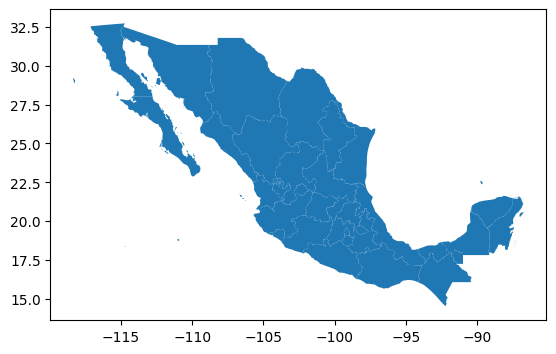

In [13]:
# plot states
gdf_mex_states.plot()

---
# Geographical Clustering

## S1: Define minimum number of points to form a cluster

In [7]:
# from crs 4326 to 6372
gdf_properties = gdf_properties.to_crs('EPSG:6372')

# get lon and lat
gdf_properties['longitude'] = gdf_properties.geometry.x
gdf_properties['latitude'] = gdf_properties.geometry.y

In [16]:
# define function to get poiunts at r distance
def get_neighbors(gdf, r):
    # fit a kdtree
    kdtree = KDTree(
        data=gdf[['longitude', 'latitude']],
    )
    # count neighbors at r-km
    gdf[f'neighbors_{r}km'] = kdtree.query_ball_point(
        gdf[['longitude', 'latitude']],
        r=r * 1_000,
        workers=-1,
        return_length=True
    )
    return gdf

# get neighbors at provided distances
list_distances = [0.1, 0.25, 0.5, 1, 2, 5]

for r in tqdm(list_distances):
    gdf_properties = get_neighbors(gdf_properties, r)

100%|██████████| 6/6 [00:23<00:00,  3.98s/it]


In [21]:
# get percentil of neighbors at N
def percentil_at_x(x, p):
    return x.gt(p).mean()

# get percentil of neighbors at N
N_MIN_NEIGHBORS = 10


In [24]:
# General
(
    gdf_properties
    .filter(like='neighbors')
    .apply(
        lambda x: percentil_at_x(x, N_MIN_NEIGHBORS)
    )
    .sort_values()
)


neighbors_0.1km     0.571567
neighbors_0.25km    0.856018
neighbors_0.5km     0.956303
neighbors_1km       0.983612
neighbors_2km       0.991426
neighbors_5km       0.995659
dtype: float64

In [30]:
# now see it at state level
(
    gdf_properties
    .groupby('id_entidad_f')
    .apply(
        lambda x: x.filter(like='neighbors').apply(
            lambda x: percentil_at_x(x, N_MIN_NEIGHBORS)
        )
    )
    .T
    .sort_index()
    .style.format("{:.0%}")
)

/var/folders/42/2lkg1sf91wv7mjxw6klfcqtc0000gn/T/ipykernel_17275/2294535042.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(


id_entidad_f,01,02,03,04,05,06,07,08,09,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32
neighbors_0.1km,68%,38%,45%,16%,52%,51%,36%,51%,50%,52%,64%,43%,68%,67%,53%,50%,54%,56%,70%,30%,58%,67%,76%,53%,54%,49%,34%,54%,40%,40%,60%,55%
neighbors_0.25km,93%,70%,76%,63%,86%,86%,66%,87%,87%,86%,88%,75%,88%,90%,82%,80%,80%,84%,94%,52%,84%,92%,94%,89%,87%,84%,58%,87%,61%,72%,79%,81%
neighbors_0.5km,99%,90%,93%,89%,98%,97%,86%,97%,99%,97%,96%,89%,94%,97%,94%,93%,94%,95%,99%,71%,94%,98%,98%,96%,97%,96%,80%,97%,81%,89%,94%,93%
neighbors_1km,99%,97%,98%,95%,99%,99%,95%,99%,100%,99%,98%,96%,97%,99%,98%,97%,98%,98%,100%,88%,97%,99%,99%,99%,99%,99%,90%,99%,94%,95%,98%,97%
neighbors_2km,100%,99%,99%,97%,100%,99%,97%,100%,100%,99%,99%,98%,99%,99%,99%,99%,99%,99%,100%,93%,99%,99%,100%,99%,99%,99%,95%,99%,98%,97%,99%,98%
neighbors_5km,100%,100%,99%,97%,100%,100%,98%,100%,100%,100%,100%,98%,99%,100%,100%,99%,100%,99%,100%,96%,99%,100%,100%,99%,100%,100%,98%,100%,99%,98%,99%,99%


^^^ it seems that 0.5km is the best distance to get at least 10 neighbors

## S2: Cluster Points Within 500m

In [49]:
# use dbscan to cluster
eps = 1000  # 500 meters of distance
min_samples = 10  # 10 points to consider a cluster

# get the clusters
dbscan = DBSCAN(eps=eps, min_samples=min_samples)
gdf_properties['cluster'] = dbscan.fit_predict(gdf_properties[['longitude', 'latitude']])

In [50]:
# identify the isolated points
print(gdf_properties['cluster'].eq(-1).mean())
print(gdf_properties['cluster'].eq(-1).sum())

0.011175166297117517
11718


<Axes: >

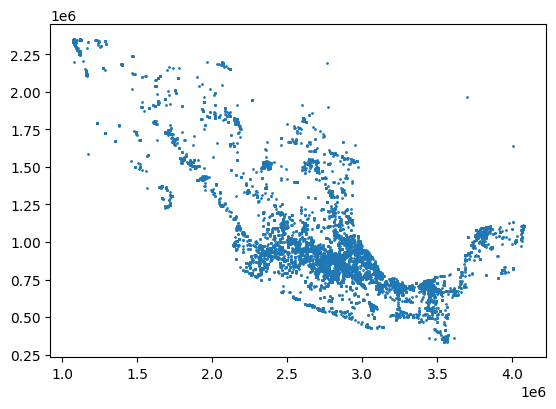

In [51]:
# plot isolated points
gdf_properties[gdf_properties['cluster'].eq(-1)].plot(markersize=1)

In [52]:
# explore isolated points
gdf_properties[gdf_properties['cluster'].eq(-1)].loc[:, ['geometry', 'colonia']].explore()

In [57]:
# for id_entidad_f = 09 look at the isolated points
(
    gdf_properties
    .query('id_entidad_f == "09"')
    .assign(isolated=lambda x: x['cluster'].eq(-1))
    .loc[:, ['geometry', 'colonia', 'isolated']]
    .explore('isolated', color='red')
)